In [1]:
%%time
# Importing the required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime as dt_obj
from scipy import signal
from matplotlib.dates import DateFormatter
import warnings
warnings.filterwarnings('ignore')

# Function to convert string to date_time object
def to_date(tstr):
    year   = int(tstr[:4])
    month  = int(tstr[5:7])
    day    = int(tstr[8:10])
    hour   = int(tstr[11:13])
    minute = int(tstr[14:16])
    return dt_obj(year, month, day, hour, minute)

# Function to convert into numpy array
def to_array(List):
    l = np.array(List)
    l = l.flatten()
    return l 

# Outlier masking function
def is_outlier(points, thresh=3.5):
    """
    Returns a boolean array with True if points are outliers and False 
    otherwise.

    Parameters:
    -----------
        points : An numobservations by numdimensions array of observations
        thresh : The modified z-score to use as a threshold. Observations with
            a modified z-score (based on the median absolute deviation) greater
            than this value will be classified as outliers.

    Returns:
    --------
        mask : A numobservations-length boolean array.

    References:
    ----------
        Boris Iglewicz and David Hoaglin (1993), "Volume 16: How to Detect and
        Handle Outliers", The ASQC Basic References in Quality Control:
        Statistical Techniques, Edward F. Mykytka, Ph.D., Editor. 
    """
    if len(points.shape) == 1:
        points = points[:,None]
    median = np.median(points, axis=0)
    diff = np.sum((points - median)**2, axis=-1)
    diff = np.sqrt(diff.astype(float))
    med_abs_deviation = np.median(diff)

    modified_z_score = 0.6745 * diff / med_abs_deviation

    return modified_z_score > thresh

Wall time: 1.12 s


In [2]:
%%time
# Importing the dataset                         
data_with_spec = pd.read_csv('AR_Numbered_with_Spectogram.csv', low_memory=False)
data_with_spec

Wall time: 27 s


,T_REC,HARPNUM,NOAA_ARS,NOAA_AR,LON_FWT,LAT_FWT,TOTUSJH,TOTPOT,TOTUSJZ,ABSNJZH,...,spec_R_VALUE,spec_SHRGT45,spec_MEANSHR,spec_MEANGAM,spec_MEANGBT,spec_MEANGBZ,spec_MEANGBH,spec_MEANJZH,spec_MEANJZD,spec_MEANALP
0,2010.05.02_00:00:00_TAI,1,11067,11067,-65.205566,24.177683,0.431914,0.173426,0.407741,0.274315,...,0.363596,0.071753,0.315126,0.291895,0.696870,0.686968,0.485529,0.161536,0.208680,0.185819
1,2010.05.06_02:36:00_TAI,1,11067,11067,-11.296749,24.437330,0.386188,0.150954,0.441300,0.286204,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2010.05.06_02:24:00_TAI,1,11067,11067,-11.390746,24.432217,0.366822,0.143423,0.419162,0.345677,...,0.000000,0.035815,0.035387,0.015955,0.188202,0.167465,0.094591,0.212985,0.067217,0.246156
3,2010.05.06_02:12:00_TAI,1,11067,11067,-11.464979,24.416801,0.401588,0.161598,0.459960,0.396567,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2010.05.06_02:00:00_TAI,1,11067,11067,-11.549165,24.426493,0.405624,0.159411,0.457335,0.353532,...,0.000000,0.013664,0.030240,0.009161,0.199613,0.186046,0.105027,0.205703,0.180470,0.234001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2653239,2021.12.30_19:36:00_TAI,7912,12923,12923,34.538128,-28.941851,-0.274226,-0.119751,-0.280315,-0.236345,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2653240,2021.12.30_19:24:00_TAI,7912,12923,12923,34.414345,-28.956635,-0.275551,-0.121126,-0.284907,-0.236709,...,0.000000,0.387834,0.315290,0.683566,0.442772,0.374041,0.311624,2.126444,3.739967,1.991129
2653241,2021.12.30_23:48:00_TAI,7912,12923,12923,37.471878,-28.819061,-0.220019,-0.097749,-0.222000,-0.208777,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2653242,2021.12.30_21:24:00_TAI,7912,12923,12923,36.186848,-28.818560,-0.246997,-0.107325,-0.260590,-0.186425,...,0.000000,0.314082,0.454034,0.586965,0.402897,0.385181,0.267229,0.606116,1.291985,0.359731


In [3]:
%%time
# Converting date_time from str to date_time object
date_time = data_with_spec.iloc[:,0]
date_time = [to_date(i) for i in date_time]
data_with_spec.loc[:,'date_time'] = date_time

Wall time: 10.1 s


In [4]:
data_with_spec.iloc[:,34:53]

,spec_TOTUSJH,spec_TOTPOT,spec_TOTUSJZ,spec_ABSNJZH,spec_SAVNCPP,spec_USFLUX,spec_AREA_ACR,spec_MEANPOT,spec_R_VALUE,spec_SHRGT45,spec_MEANSHR,spec_MEANGAM,spec_MEANGBT,spec_MEANGBZ,spec_MEANGBH,spec_MEANJZH,spec_MEANJZD,spec_MEANALP
0,0.205481,0.081677,0.212757,0.140224,0.061002,0.327130,0.373092,0.105966,0.363596,0.071753,0.315126,0.291895,0.696870,0.686968,0.485529,0.161536,0.208680,0.185819
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.192692,0.076660,0.220489,0.186865,0.162127,0.167095,0.371836,0.011991,0.000000,0.035815,0.035387,0.015955,0.188202,0.167465,0.094591,0.212985,0.067217,0.246156
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.202131,0.079577,0.228331,0.176705,0.111887,0.170558,0.373834,0.008918,0.000000,0.013664,0.030240,0.009161,0.199613,0.186046,0.105027,0.205703,0.180470,0.234001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2653239,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2653240,0.126205,0.055647,0.129621,0.112026,0.156190,0.123893,0.153393,0.164408,0.000000,0.387834,0.315290,0.683566,0.442772,0.374041,0.311624,2.126444,3.739967,1.991129
2653241,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2653242,0.116429,0.050796,0.120959,0.099940,0.122220,0.116562,0.146432,0.217464,0.000000,0.314082,0.454034,0.586965,0.402897,0.385181,0.267229,0.606116,1.291985,0.359731


## Method 1: Sum of All Parameter

The first method in labelling is determining the label of datapoints based on its summed value of each parameters. From the previous section, we already have ranked all the parameter based on its behavior on flaring AR. We only choose parameters with considerable (ratio > 1) flutuation on flaring AR.

First we need to sum all the specral correlation on all parameter and determine its statistics to get the threshold

In [1]:
(36+535)/2651020

0.00021538879374731235

In [5]:
# Make a new column as the total summed spectral correlation on each parameter
tot = data_with_spec.iloc[:,34:46].sum(axis=1)
data_with_spec['Total_Spec'] = tot
data_with_spec

,T_REC,HARPNUM,NOAA_ARS,NOAA_AR,LON_FWT,LAT_FWT,TOTUSJH,TOTPOT,TOTUSJZ,ABSNJZH,...,spec_SHRGT45,spec_MEANSHR,spec_MEANGAM,spec_MEANGBT,spec_MEANGBZ,spec_MEANGBH,spec_MEANJZH,spec_MEANJZD,spec_MEANALP,Total_Spec
0,2010.05.02_00:00:00_TAI,1,11067,11067,-65.205566,24.177683,0.431914,0.173426,0.407741,0.274315,...,0.071753,0.315126,0.291895,0.696870,0.686968,0.485529,0.161536,0.208680,0.185819,2.549700
1,2010.05.06_02:36:00_TAI,1,11067,11067,-11.296749,24.437330,0.386188,0.150954,0.441300,0.286204,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000
2,2010.05.06_02:24:00_TAI,1,11067,11067,-11.390746,24.432217,0.366822,0.143423,0.419162,0.345677,...,0.035815,0.035387,0.015955,0.188202,0.167465,0.094591,0.212985,0.067217,0.246156,1.476911
3,2010.05.06_02:12:00_TAI,1,11067,11067,-11.464979,24.416801,0.401588,0.161598,0.459960,0.396567,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000
4,2010.05.06_02:00:00_TAI,1,11067,11067,-11.549165,24.426493,0.405624,0.159411,0.457335,0.353532,...,0.013664,0.030240,0.009161,0.199613,0.186046,0.105027,0.205703,0.180470,0.234001,1.405007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2653239,2021.12.30_19:36:00_TAI,7912,12923,12923,34.538128,-28.941851,-0.274226,-0.119751,-0.280315,-0.236345,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000
2653240,2021.12.30_19:24:00_TAI,7912,12923,12923,34.414345,-28.956635,-0.275551,-0.121126,-0.284907,-0.236709,...,0.387834,0.315290,0.683566,0.442772,0.374041,0.311624,2.126444,3.739967,1.991129,2.408072
2653241,2021.12.30_23:48:00_TAI,7912,12923,12923,37.471878,-28.819061,-0.220019,-0.097749,-0.222000,-0.208777,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000
2653242,2021.12.30_21:24:00_TAI,7912,12923,12923,36.186848,-28.818560,-0.246997,-0.107325,-0.260590,-0.186425,...,0.314082,0.454034,0.586965,0.402897,0.385181,0.267229,0.606116,1.291985,0.359731,2.345885


In [6]:
%%time
# Obtain the datapoints with spectral correlation only
with_spec_only = data_with_spec.copy()

for i in range(34, 52):
    with_spec_only = with_spec_only[with_spec_only[with_spec_only.columns[i]].notna()]
    
with_spec_only = with_spec_only.reset_index()
with_spec_only = with_spec_only.drop(columns = ['index'])
with_spec_only

Wall time: 7.41 s


,T_REC,HARPNUM,NOAA_ARS,NOAA_AR,LON_FWT,LAT_FWT,TOTUSJH,TOTPOT,TOTUSJZ,ABSNJZH,...,spec_SHRGT45,spec_MEANSHR,spec_MEANGAM,spec_MEANGBT,spec_MEANGBZ,spec_MEANGBH,spec_MEANJZH,spec_MEANJZD,spec_MEANALP,Total_Spec
0,2010.05.02_00:00:00_TAI,1,11067,11067,-65.205566,24.177683,0.431914,0.173426,0.407741,0.274315,...,0.071753,0.315126,0.291895,0.696870,0.686968,0.485529,0.161536,0.208680,0.185819,2.549700
1,2010.05.06_02:24:00_TAI,1,11067,11067,-11.390746,24.432217,0.366822,0.143423,0.419162,0.345677,...,0.035815,0.035387,0.015955,0.188202,0.167465,0.094591,0.212985,0.067217,0.246156,1.476911
2,2010.05.06_02:00:00_TAI,1,11067,11067,-11.549165,24.426493,0.405624,0.159411,0.457335,0.353532,...,0.013664,0.030240,0.009161,0.199613,0.186046,0.105027,0.205703,0.180470,0.234001,1.405007
3,2010.05.06_01:36:00_TAI,1,11067,11067,-11.849483,24.417578,0.417033,0.161682,0.464194,0.627544,...,0.043642,0.058050,0.022265,0.228286,0.217532,0.116308,0.290172,0.085539,0.321404,1.713891
4,2010.05.06_01:12:00_TAI,1,11067,11067,-12.076998,24.408506,0.418819,0.164707,0.470956,0.585934,...,0.034334,0.044042,0.008884,0.234503,0.222883,0.121805,0.289738,0.124010,0.315210,1.699865
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328811,2021.12.30_20:48:00_TAI,7912,12923,12923,35.638550,-28.827433,-0.259085,-0.115789,-0.268036,-0.165347,...,0.235219,0.112309,0.256817,0.413384,0.464560,0.388035,1.428808,3.456400,1.091585,1.462281
1328812,2021.12.30_20:24:00_TAI,7912,12923,12923,35.370441,-28.834038,-0.255288,-0.115149,-0.263699,-0.157492,...,0.150121,0.142743,0.214078,0.510332,0.603773,0.297824,1.416836,4.693674,1.129941,1.373289
1328813,2021.12.30_19:48:00_TAI,7912,12923,12923,34.965431,-28.854717,-0.260989,-0.115500,-0.269149,-0.149183,...,0.494535,0.630904,1.285038,0.301644,0.383272,0.140132,1.327406,2.815476,1.323716,3.332092
1328814,2021.12.30_19:24:00_TAI,7912,12923,12923,34.414345,-28.956635,-0.275551,-0.121126,-0.284907,-0.236709,...,0.387834,0.315290,0.683566,0.442772,0.374041,0.311624,2.126444,3.739967,1.991129,2.408072


In [7]:
# Declare all variable needed for labeling process
arr = to_array(with_spec_only['Total_Spec'])                                              # We need to get the Total_Spec 
filtered_tot_spec = arr[~is_outlier(arr)]                                                 # And get the statistics of the noise 
thres = np.average(filtered_tot_spec) + 2.5*np.std(filtered_tot_spec)                     # Get the threshold (98.758 % of the noise)

with_spec_only['LABEL'] = [-1 for i in range(len(with_spec_only))]                        # Create LABEL column
with_spec_only['data_index'] = [int(i) for i in range(len(with_spec_only))]               # Reset the data_index

flare_events = data_with_spec.loc[data_with_spec['X_or_M'] == 'Y']                        # Get the flare events    
HARPNUM = flare_events['HARPNUM'].drop_duplicates()                                       # Get the HARPNUM of flaring ARs
positive = []                                                                             # Create a blank list to contain data indexes with positive value

In [8]:
%%time
# Labeling Process
for i in HARPNUM:
    data = with_spec_only.loc[with_spec_only['HARPNUM'] == i]
    DATA = data_with_spec.loc[data_with_spec['HARPNUM'] == i]
    time = to_array(data['date_time'])
    time_XM = to_array(DATA.loc[DATA['X_or_M'] == 'Y'].date_time)
    index = to_array(data['data_index'])
    tot = to_array(data['Total_Spec'])
    for j in range(len(data)):
        if (tot[j] > thres) and (np.max(time_XM) - time[j] > 0):
            positive.append(index[j])

len(positive)

Wall time: 1.97 s


53725

In [9]:
%%time
# Duplicate filtering
# Function to remove duplicate from a list
def rm_dup_list(test_list):
    res = []
    for i in test_list:
        if i not in res:
            res.append(i)
    return res

positive_no_dup = rm_dup_list(positive)
len(positive_no_dup)

Wall time: 24.8 s


53725

In [10]:
%%time
# Assigning positive label to AR dataset
with_spec_only.loc[np.array(positive_no_dup), 'LABEL'] = 1
with_spec_only.loc[with_spec_only['LABEL'] == 1]

Wall time: 28 ms


,T_REC,HARPNUM,NOAA_ARS,NOAA_AR,LON_FWT,LAT_FWT,TOTUSJH,TOTPOT,TOTUSJZ,ABSNJZH,...,spec_MEANSHR,spec_MEANGAM,spec_MEANGBT,spec_MEANGBZ,spec_MEANGBH,spec_MEANJZH,spec_MEANJZD,spec_MEANALP,Total_Spec,LABEL
1040,2010.05.02_23:48:00_TAI,8,11069,11069,2.867877,41.161686,-0.211813,-0.092531,-0.210324,-0.154217,...,0.112302,0.074168,0.539704,0.505482,0.300651,0.587524,0.583191,0.536186,6.578727,1
1067,2010.05.02_15:00:00_TAI,8,11069,11069,-1.624679,41.506165,-0.255661,-0.107896,-0.260921,-0.214024,...,0.059802,0.221493,0.404901,0.405655,0.392363,0.617521,0.085348,0.525963,7.723649,1
1074,2010.05.02_14:48:00_TAI,8,11069,11069,-1.759250,41.513409,-0.257264,-0.109169,-0.263184,-0.234677,...,0.043830,0.296778,0.436929,0.423733,0.407167,0.628401,0.057482,0.580907,7.635339,1
1147,2010.05.02_20:00:00_TAI,8,11069,11069,1.027600,41.176575,-0.221335,-0.096591,-0.225805,-0.170776,...,0.401772,0.399043,0.304265,0.217169,0.264958,0.997841,0.275580,0.728381,13.096525,1
1148,2010.05.03_00:00:00_TAI,8,11069,11069,2.955749,41.168804,-0.210066,-0.093310,-0.208331,-0.219088,...,0.321850,0.322866,0.330463,0.257415,0.113200,1.354331,0.290872,0.989435,13.983678,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1327065,2021.12.25_10:36:00_TAI,7891,12918,12918,-19.003786,19.612686,2.489129,3.658610,2.672816,-0.058169,...,1.128538,1.034010,0.082017,0.025267,0.391045,0.039780,0.070599,0.031877,12.155285,1
1327066,2021.12.25_10:24:00_TAI,7891,12918,12918,-19.122381,19.613998,2.483091,3.687161,2.667598,-0.052952,...,1.103803,1.015822,0.081790,0.044400,0.401053,0.038538,0.035133,0.031294,12.101053,1
1327067,2021.12.25_11:24:00_TAI,7891,12918,12918,-18.582695,19.611193,2.637957,3.663257,2.764530,0.254238,...,1.079424,1.000285,0.044680,0.046916,0.422095,0.043511,0.036242,0.032769,11.950810,1
1327068,2021.12.25_11:48:00_TAI,7891,12918,12918,-18.409466,19.618046,2.696353,3.650748,2.848595,0.233191,...,1.076230,0.989872,0.019440,0.071856,0.448041,0.055102,0.057746,0.039626,11.753581,1


In [16]:
%%time
with_spec_only.to_csv('Labeled_Dataset.csv', index=False)

In [17]:
with_spec_only.columns

Index(['T_REC', 'HARPNUM', 'NOAA_ARS', 'NOAA_AR', 'LON_FWT', 'LAT_FWT',
       'TOTUSJH', 'TOTPOT', 'TOTUSJZ', 'ABSNJZH', 'SAVNCPP', 'USFLUX',
       'AREA_ACR', 'MEANPOT', 'R_VALUE', 'SHRGT45', 'MEANSHR', 'MEANGAM',
       'MEANGBT', 'MEANGBZ', 'MEANGBH', 'MEANJZH', 'MEANJZD', 'MEANALP',
       'date_time', 'Max', 'Type', 'Reg', 'CLASS', 'class', 'X_or_M',
       'flare_index', 'LOOK', 'data_index', 'spec_TOTUSJH', 'spec_TOTPOT',
       'spec_TOTUSJZ', 'spec_ABSNJZH', 'spec_SAVNCPP', 'spec_USFLUX',
       'spec_AREA_ACR', 'spec_MEANPOT', 'spec_R_VALUE', 'spec_SHRGT45',
       'spec_MEANSHR', 'spec_MEANGAM', 'spec_MEANGBT', 'spec_MEANGBZ',
       'spec_MEANGBH', 'spec_MEANJZH', 'spec_MEANJZD', 'spec_MEANALP',
       'Total_Spec', 'LABEL'],
      dtype='object')

## Plotting

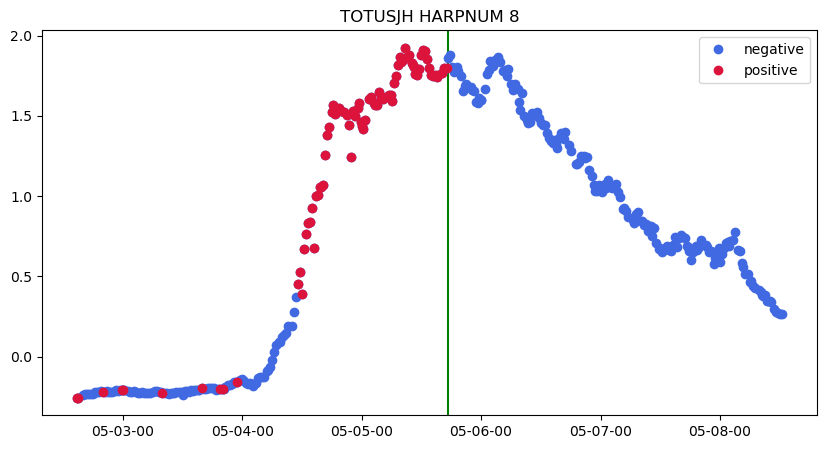

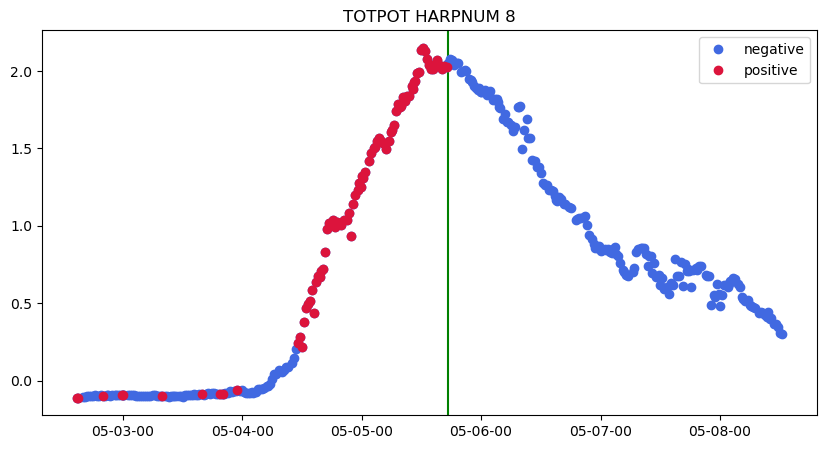

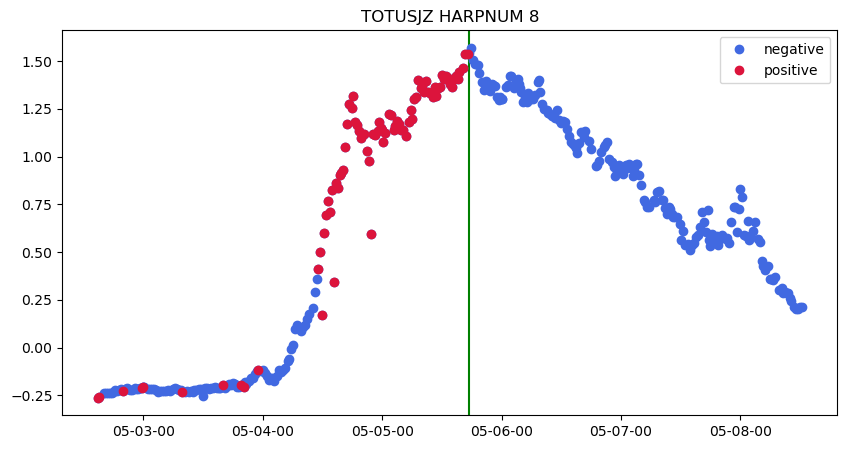

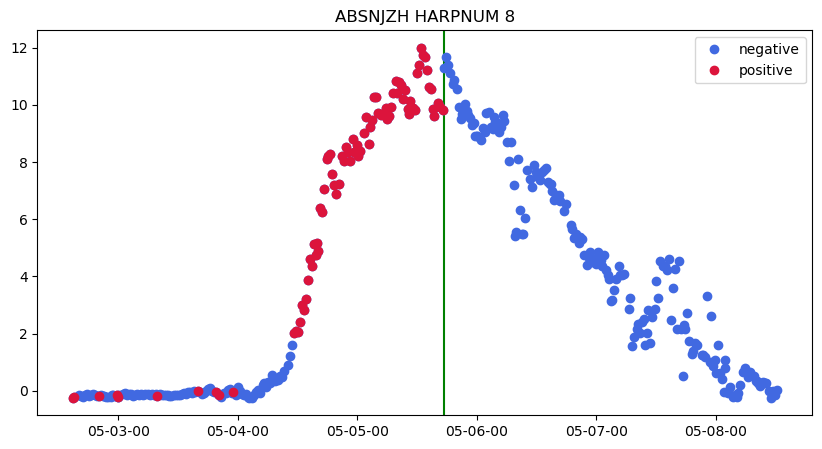

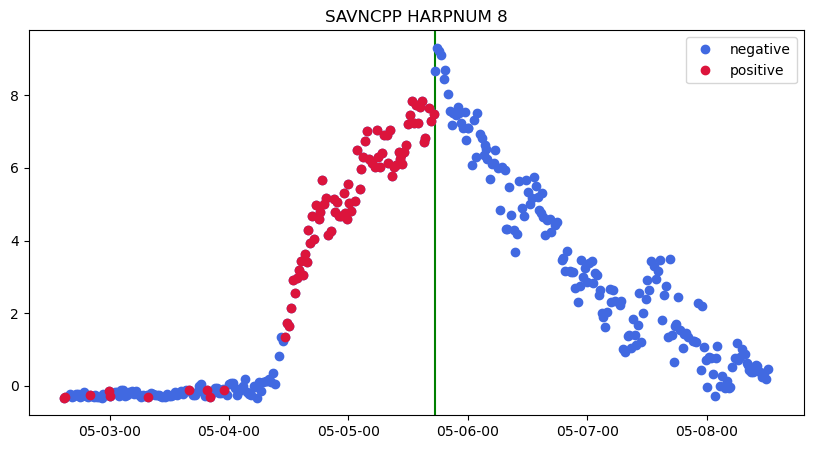

...

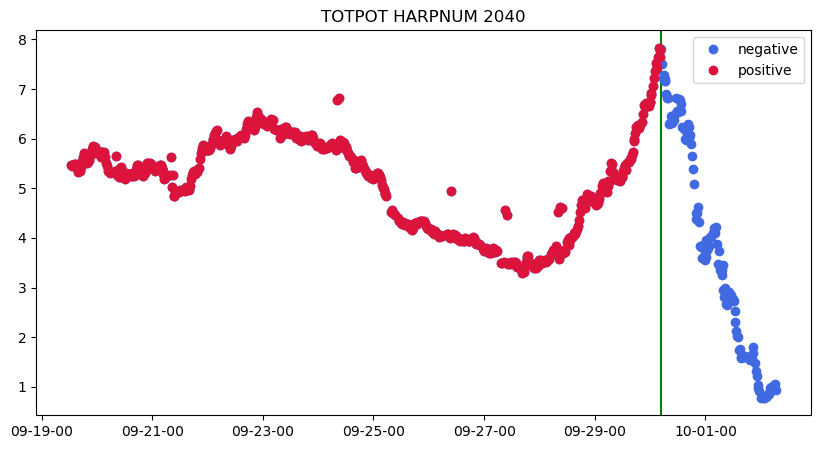

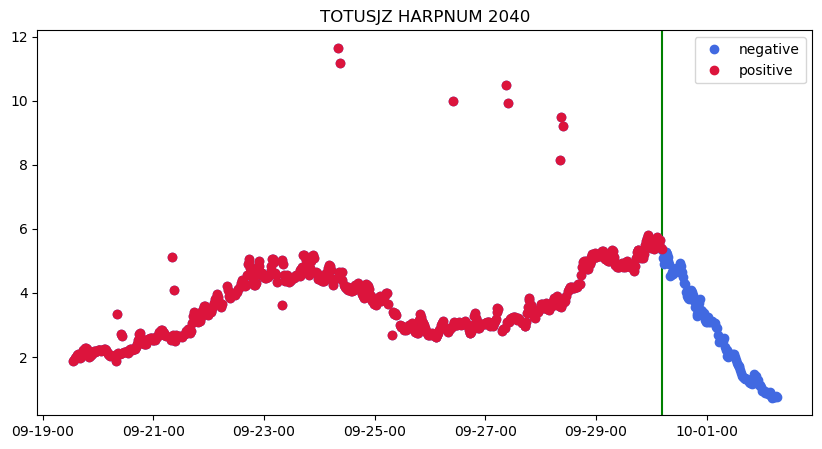

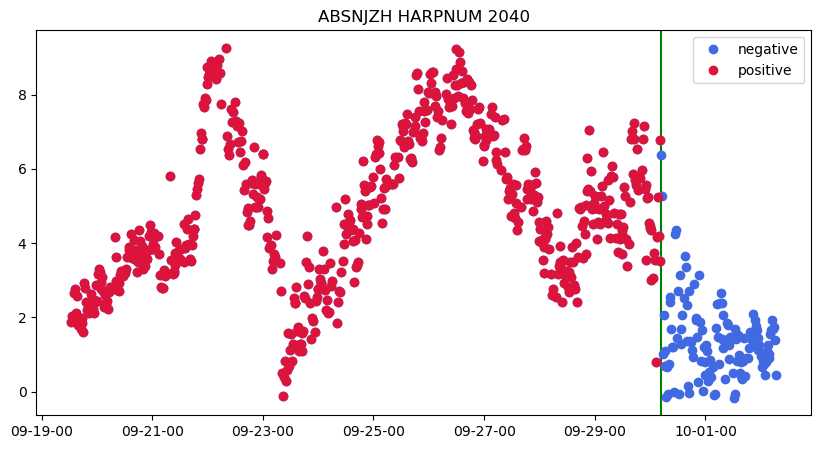

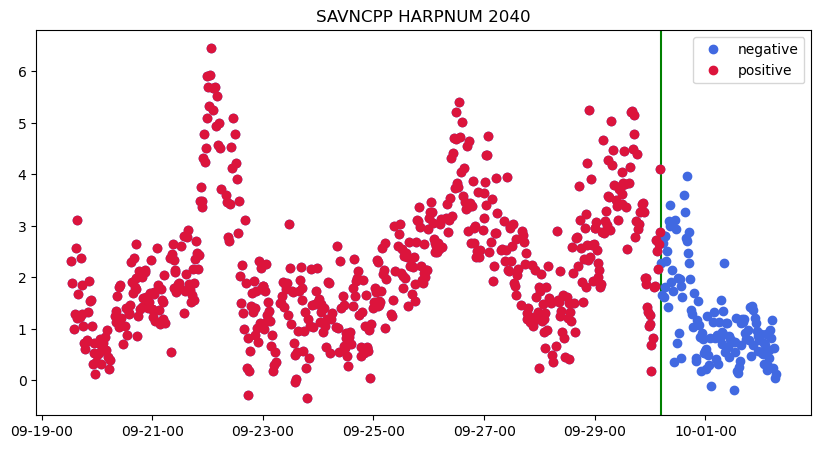

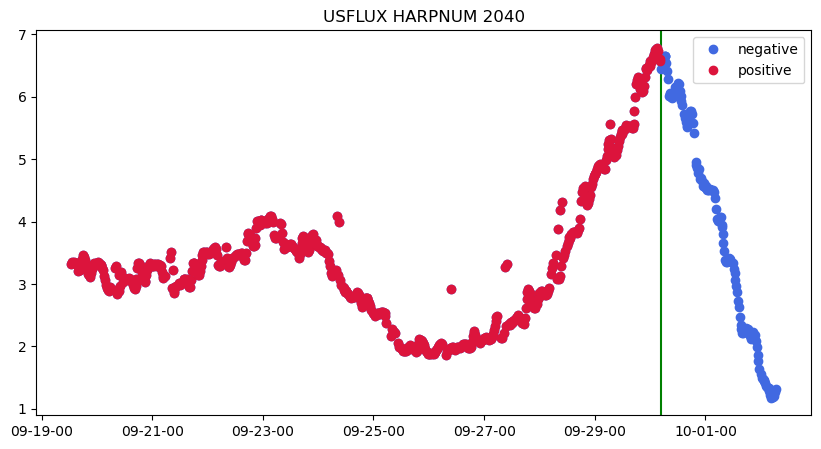

KeyboardInterrupt: 

In [15]:
%%time
for i in HARPNUM:
    for col_index in range(6, 18):
        data = with_spec_only.loc[with_spec_only['HARPNUM'] == i]
        X = to_array(data['date_time'])
        Y = to_array(data.iloc[:,col_index])
        positive = data.loc[data['LABEL'] == 1]
        flare_time = to_array(positive['date_time'])
        y_flare = to_array(positive.iloc[:,col_index])

        fig, ax = plt.subplots(figsize = (10, 5))
        FLARES = data_with_spec.loc[(data_with_spec['X_or_M'] == 'Y') & (data_with_spec['HARPNUM'] == i)]
        FLARE_TIMESTAMPS = to_array(FLARES['date_time'])
        CLASS = to_array(FLARES['class'])
        for j in range(len(FLARES)):
            if CLASS[j] == 'M':
                plt.axvline(x = FLARE_TIMESTAMPS[j], color = 'g')
            elif CLASS[j] == 'X':
                plt.axvline(x = FLARE_TIMESTAMPS[j], color = 'r')     

        plt.plot(X, Y, 'o', color = 'royalblue', label = 'negative')
        plt.plot(flare_time, y_flare, 'o', color = 'crimson', label = 'positive')
        plt.title(str(data.columns[col_index]) + " HARPNUM " + str(i))
        date_form = DateFormatter("%m-%d-%H")
        ax.xaxis.set_major_formatter(date_form)
        plt.legend()
        plt.show()

    fig, ax = plt.subplots(figsize = (10, 5))
    tot = to_array(with_spec_only.loc[with_spec_only['HARPNUM'] == i].Total_Spec)
    plt.plot(X, tot, 'o')
    plt.axhline(y = thres, color = 'g')
    plt.title('Total_Spec of HARPNUM ' + str(i))
    plt.show()